The goal of this project is to use a create a neural network to determine if a chord played is in major key or minor key

The Dataset used is from kaggle [here](https://www.kaggle.com/deepcontractor/musical-instrument-chord-classification)

Steps taken from this [blog post](https://www.kdnuggets.com/2020/02/audio-data-analysis-deep-learning-python-part-1.html)

Steps to take:
* Read in wav file and convert to an array for a neural network to read
* determine the type of neural network to use for binary classification
* After creating a basic neural network, tune neural network

# Read in a Wav file and convert to an array for a neural network

After research, I can use the [Librosa](https://librosa.org/doc/latest/install.html) library to build a Music Information Retrieval system 

In [1]:
pip install librosa

Note: you may need to restart the kernel to use updated packages.


## Loading one .wav file into an array

In [2]:
#importing librosa library
import librosa

# Path to an audio file
filename = 'Audio_Files\Major\Major_2.wav'

# load the the audio as a waveform 'y'
y, sr = librosa.load(filename)

In [3]:
# y is an audio times series array
y

array([-0.0035924 , -0.00574013, -0.00507032, ...,  0.        ,
        0.        ,  0.        ], dtype=float32)

In [4]:
# sr is the sampling rate of y
sr

22050

## Loading all wav files into  two arrays(one for major chords, one for minor chords)

In [5]:
import os
import glob
path = 'Audio_Files\Major'
major_array = []
for filename in glob.glob(os.path.join(path, '*.wav')):
    y, sr = librosa.load(filename)
    major_array.append(y)

In [6]:
len(major_array)

460

In [7]:
path_minor = 'Audio_Files\Minor'
minor_array = []
for filename in glob.glob(os.path.join(path_minor, '*.wav')):
    y, sr = librosa.load(filename)
    minor_array.append(y)

## Add major(1) and minor(10) classification to each time series array

In [8]:
major_class = []
for array in major_array:
    major_class.append(array)
minor_class = []
for array in minor_array:
    minor_class.append(array)

### Predictive model without neural network

In [9]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import RandomForestClassifier



In [10]:
df_major = pd.DataFrame(major_class)
df_minor = pd.DataFrame(minor_class)

In [11]:
df_major_target = pd.Series([1 for a in range(len(major_class))])
df_minor_target = pd.Series([0 for a in range(len(minor_class))])

### Set Features and Target

In [12]:
X = df_major.append(df_minor)

In [13]:
X = X.fillna(0.0)

In [14]:
y = df_major_target.append(df_minor_target)

In [15]:
y = pd.concat([df_major_target, df_minor_target], axis=0)

### train, validation, test split

In [16]:
X_train, X_test, y_train, y_test= train_test_split(X, y, test_size = 0.2, random_state=42)

In [17]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size = 0.2, random_state=42)

### Baseline

In [18]:
print('Baseline Accuracy', y_train.value_counts(normalize=True).max())

Baseline Accuracy 0.5517241379310345


### Build Model

In [19]:
model = LogisticRegression(max_iter=50000)
model.fit(X_train, y_train)

LogisticRegression(max_iter=50000)

### Check Metrics

In [20]:
print("Training Accuracy", model.score(X_train, y_train))
print("Validation Accuary", model.score(X_val, y_val))

Training Accuracy 0.9022988505747126
Validation Accuary 0.648854961832061


Model is able to predict correct 64% of the time, which is over the baseline of 55%. Next lets try Random Forest

In [21]:
model_rf = RandomForestClassifier()
model_rf.fit(X_train, y_train)

RandomForestClassifier()

In [22]:
print("Training Accuracy", model_rf.score(X_train, y_train))
print("Validation Accuary", model_rf.score(X_val, y_val))

Training Accuracy 0.9942528735632183
Validation Accuary 0.7709923664122137


In [23]:
model_cf = DecisionTreeClassifier()
model_cf.fit(X_train, y_train)

DecisionTreeClassifier()

In [24]:
print("Training Accuracy", model_cf.score(X_train, y_train))
print("Validation Accuary", model_cf.score(X_val, y_val))

Training Accuracy 0.9942528735632183
Validation Accuary 0.7557251908396947


In [25]:
print("Test Accuracy", model_cf.score(X_test, y_test))

Test Accuracy 0.6951219512195121


The test accuracy using the model with the best rated accuracy score was 67%, which beats the baseline, but not by much.

The problem with this method is not all .wav files have the exact amount of features, so I had to fill in null values with the value 0.0. Since wav files are time series files, this does alter the .wav file and could change the prediction model. Using these arrays may not product an accurate model using a Neural network so an alternate method will need to be used. Luckily, .wav files can be reproduced as images.

## Neural Network

### Creating spectrograms

In [31]:
y, sr = librosa.load(filename)

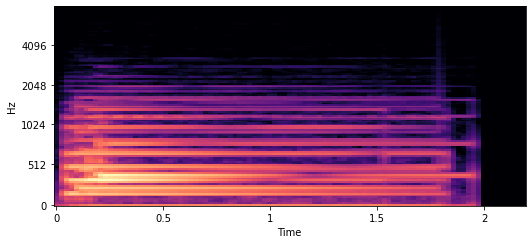

In [34]:
import matplotlib.pyplot as plt
import librosa.display
import numpy as np

plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

fig, ax = plt.subplots()

hl = 512 # number of samples per time-step in spectrogram
hi = 128 # Height of image
wi = 384 # Width of image

# Loading demo track
y, sr = librosa.load(filename)
window = y[0:wi*hl]

S = librosa.feature.melspectrogram(y=window, sr=sr, n_mels=hi, fmax=8000,
hop_length=hl)
S_dB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr, fmax=8000, ax=ax)

plt.savefig("out.png")
plt.show()

C:\Users\John\AppData\Local\Temp/ipykernel_4448/471482323.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


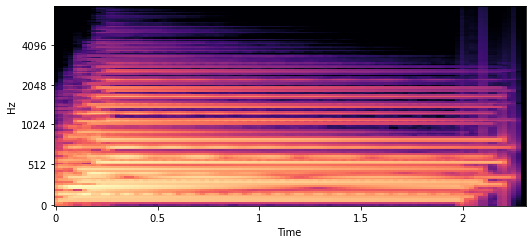

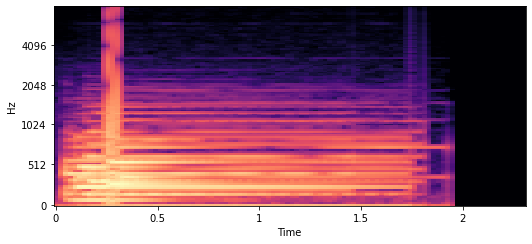

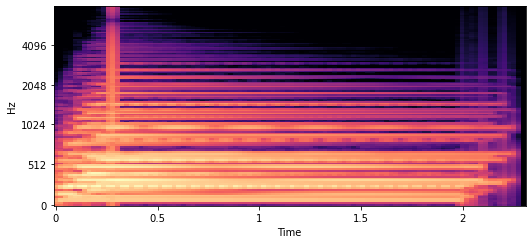

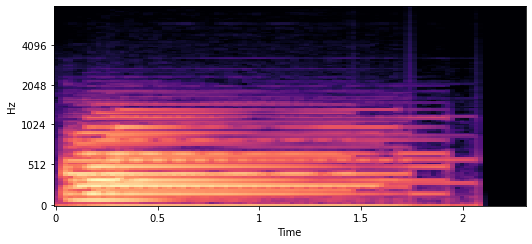

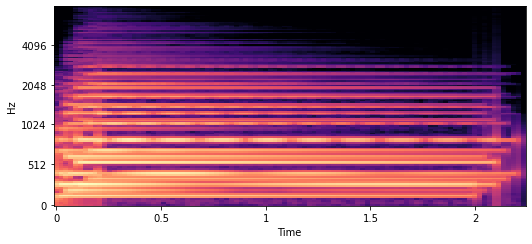

...

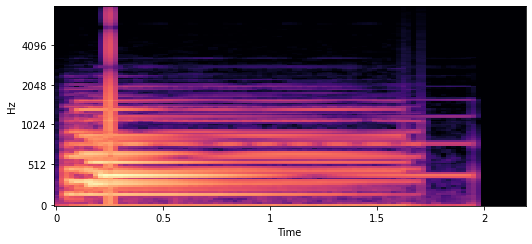

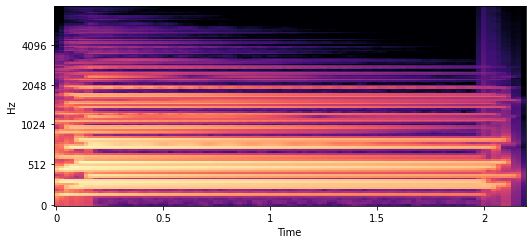

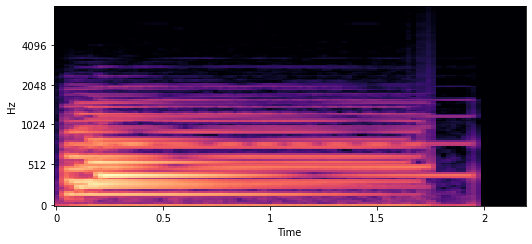

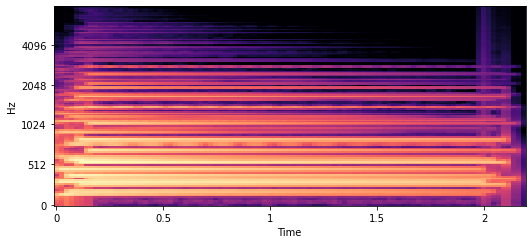

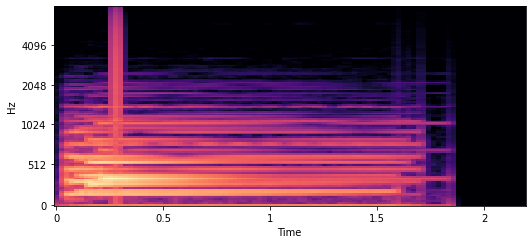

In [41]:
count = 0
for filename in glob.glob(os.path.join(path, '*.wav')):
    plt.rcParams["figure.figsize"] = [7.50, 3.50]
    plt.rcParams["figure.autolayout"] = True

    fig, ax = plt.subplots()

    hl = 512 # number of samples per time-step in spectrogram
    hi = 128 # Height of image
    wi = 384 # Width of image

    # Loading demo track
    y, sr = librosa.load(filename)
    window = y[0:wi*hl]

    S = librosa.feature.melspectrogram(y=window, sr=sr, n_mels=hi, fmax=8000,
    hop_length=hl)
    S_dB = librosa.power_to_db(S, ref=np.max)
    img = librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr, fmax=8000, ax=ax)
    
    plt.savefig(f"Audio_Files\Major_Mel_Spectrograms\major{count}.png")
    count += 1


C:\Users\John\AppData\Local\Temp/ipykernel_4448/120221550.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


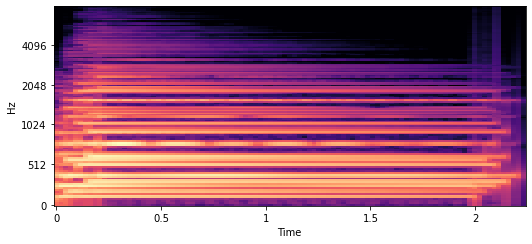

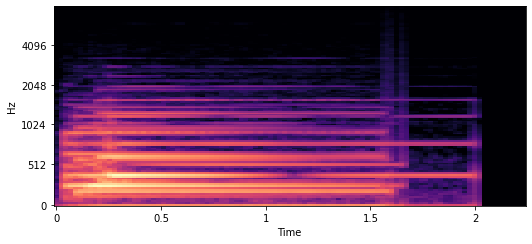

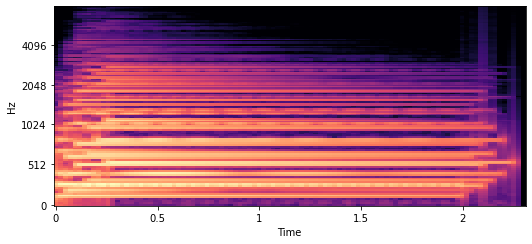

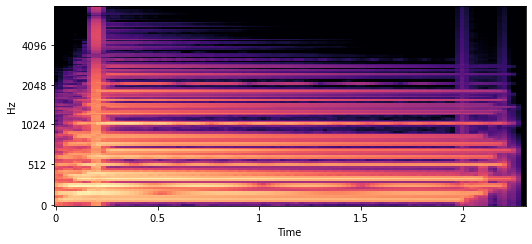

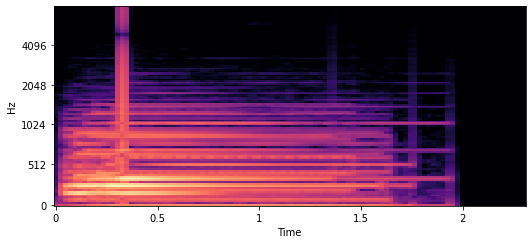

...

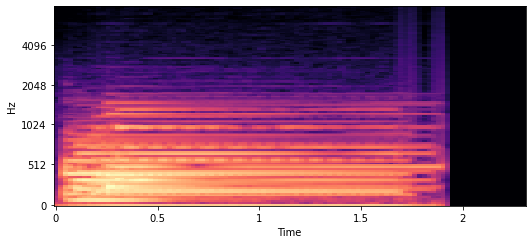

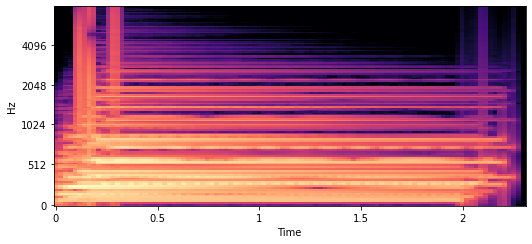

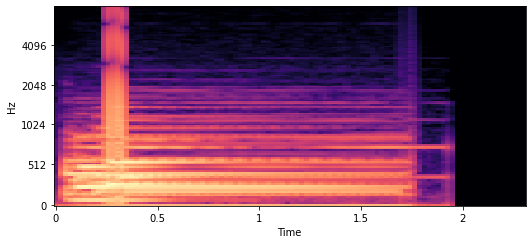

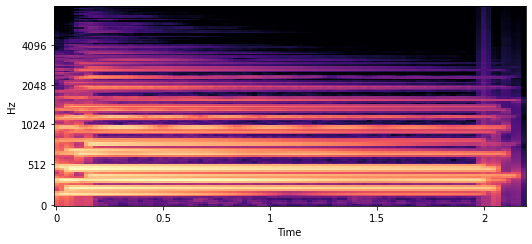

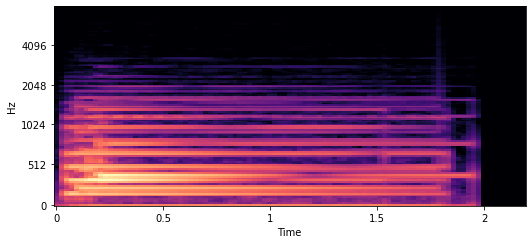

In [42]:

for filename in glob.glob(os.path.join(path_minor, '*.wav')):
    plt.rcParams["figure.figsize"] = [7.50, 3.50]
    plt.rcParams["figure.autolayout"] = True

    fig, ax = plt.subplots()

    hl = 512 # number of samples per time-step in spectrogram
    hi = 128 # Height of image
    wi = 384 # Width of image

    # Loading demo track
    y, sr = librosa.load(filename)
    window = y[0:wi*hl]

    S = librosa.feature.melspectrogram(y=window, sr=sr, n_mels=hi, fmax=8000,
    hop_length=hl)
    S_dB = librosa.power_to_db(S, ref=np.max)
    img = librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr, fmax=8000, ax=ax)
    
    plt.savefig(f"Audio_Files\Minor_Mel_Spectrograms\minor{count}.png")
    count += 1